In [1]:
from transformers import pipeline 
detector = pipeline("object-detection", model="facebook/detr-resnet-50")

/home/lucas/projects/estudos-python/.venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2024-08-05 11:44:52.877647: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-05 11:44:52.886071: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-05 11:44:52.902353: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-05 11:44:52.907092: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register fact

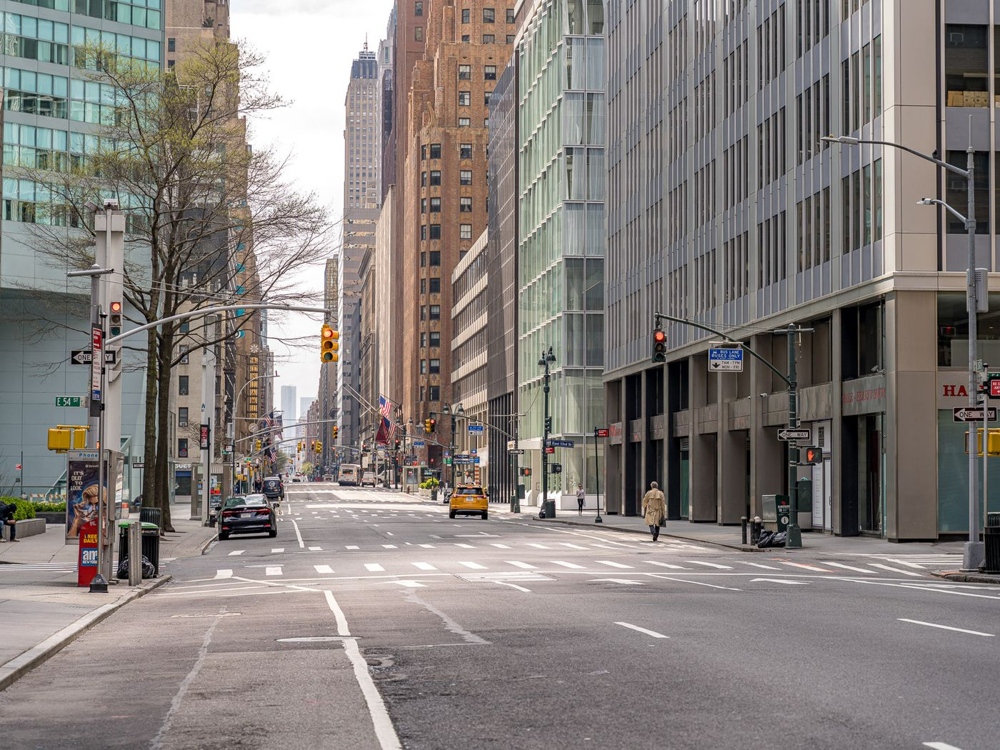

In [2]:
from pathlib import Path 
from PIL import Image 

imagem = Image.open(Path('imagens/cidades/city.jpg'))
imagem

In [3]:
deteccao = detector(imagem)
deteccao

[{'score': 0.8660395741462708,
  'label': 'traffic light',
  'box': {'xmin': 548, 'ymin': 620, 'xmax': 564, 'ymax': 641}},
 {'score': 0.989813506603241,
  'label': 'traffic light',
  'box': {'xmin': 450, 'ymin': 459, 'xmax': 472, 'ymax': 511}},
 {'score': 0.8340935111045837,
  'label': 'traffic light',
  'box': {'xmin': 540, 'ymin': 625, 'xmax': 556, 'ymax': 646}},
 {'score': 0.6735727787017822,
  'label': 'car',
  'box': {'xmin': 375, 'ymin': 664, 'xmax': 404, 'ymax': 685}},
 {'score': 0.9131616353988647,
  'label': 'traffic light',
  'box': {'xmin': 411, 'ymin': 617, 'xmax': 424, 'ymax': 635}},
 {'score': 0.8542628884315491,
  'label': 'person',
  'box': {'xmin': 807, 'ymin': 677, 'xmax': 822, 'ymax': 719}},
 {'score': 0.636502206325531,
  'label': 'person',
  'box': {'xmin': 592, 'ymin': 669, 'xmax': 609, 'ymax': 699}},
 {'score': 0.9877977967262268,
  'label': 'traffic light',
  'box': {'xmin': 147, 'ymin': 422, 'xmax': 168, 'ymax': 466}},
 {'score': 0.6702429056167603,
  'label': 

In [4]:
det = deteccao[0]
det

{'score': 0.8660395741462708,
 'label': 'traffic light',
 'box': {'xmin': 548, 'ymin': 620, 'xmax': 564, 'ymax': 641}}

Text(548, 605, 'traffic light 86.60%')

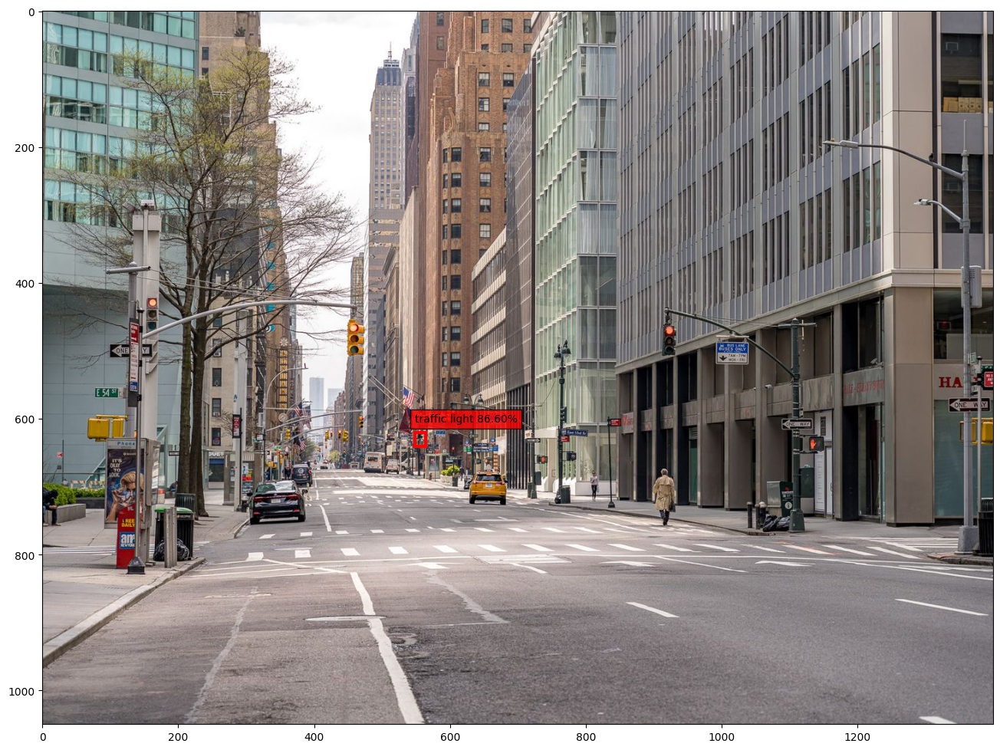

In [9]:
import matplotlib.pylab as plt 
from matplotlib import patches 

fig, ax = plt.subplots(figsize=(16,16))
ax.imshow(imagem)

box = det['box']
origem = (box['xmin'], box['ymin'])
largura = box['xmax'] - box['xmin']
altura = box['ymax'] - box['ymin']

rect = patches.Rectangle(origem, largura, altura, linewidth=3, edgecolor='red', facecolor='none' )
ax.add_patch(rect)

texto = f"{det['label']} {100 * det['score']:.2f}%"
ax.text(box['xmin'], box['ymin'] - 15, texto, bbox={'facecolor':'red', 'alpha':0.8})

In [10]:
def plotar_deteccao(imagem, deteccao):
	fig, ax = plt.subplots(figsize=(16, 16))
	ax.imshow(imagem)
    
	for det in deteccao:
		box = det['box']
		origem = (box['xmin'], box['ymin'])
		largura = box['xmax'] - box['xmin']
		altura = box['ymax'] - box['ymin']
        
		rect = patches.Rectangle(origem, largura, altura, linewidth=3, edgecolor='red', facecolor='none')
		ax.add_patch(rect)
        
		texto = f"{det['label']} {100 * det['score']:.2f}%"
		ax.text(box['xmin'], box['ymin'] - 15, texto, bbox={'facecolor': 'red', 'alpha': 0.8})

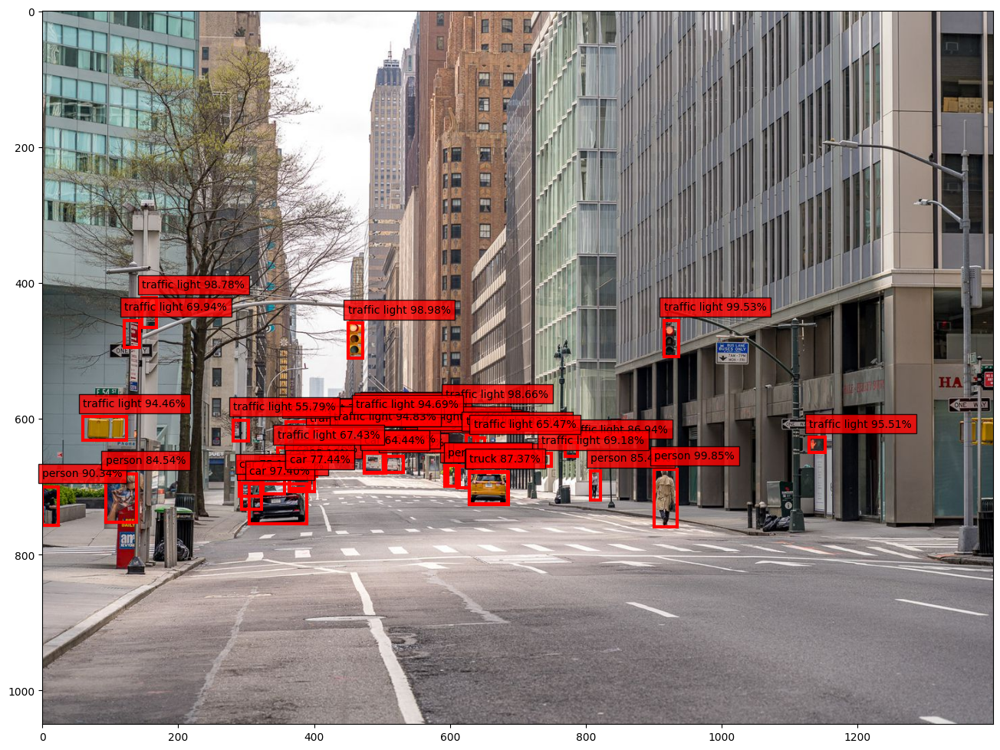

In [11]:
plotar_deteccao(imagem=imagem, deteccao=deteccao)
plt.show()

In [12]:
len(deteccao)

46

In [13]:
min(det['score'] for det in deteccao)

0.5578675866127014

In [14]:
deteccao = detector(imagem, threshold=0.5)
deteccao

[{'score': 0.8660395741462708,
  'label': 'traffic light',
  'box': {'xmin': 548, 'ymin': 620, 'xmax': 564, 'ymax': 641}},
 {'score': 0.989813506603241,
  'label': 'traffic light',
  'box': {'xmin': 450, 'ymin': 459, 'xmax': 472, 'ymax': 511}},
 {'score': 0.8340935111045837,
  'label': 'traffic light',
  'box': {'xmin': 540, 'ymin': 625, 'xmax': 556, 'ymax': 646}},
 {'score': 0.6735727787017822,
  'label': 'car',
  'box': {'xmin': 375, 'ymin': 664, 'xmax': 404, 'ymax': 685}},
 {'score': 0.9131616353988647,
  'label': 'traffic light',
  'box': {'xmin': 411, 'ymin': 617, 'xmax': 424, 'ymax': 635}},
 {'score': 0.8542628884315491,
  'label': 'person',
  'box': {'xmin': 807, 'ymin': 677, 'xmax': 822, 'ymax': 719}},
 {'score': 0.636502206325531,
  'label': 'person',
  'box': {'xmin': 592, 'ymin': 669, 'xmax': 609, 'ymax': 699}},
 {'score': 0.9877977967262268,
  'label': 'traffic light',
  'box': {'xmin': 147, 'ymin': 422, 'xmax': 168, 'ymax': 466}},
 {'score': 0.6702429056167603,
  'label': 

In [15]:
len(deteccao)

46

In [16]:
min(det['score'] for det in deteccao)

0.5578675866127014

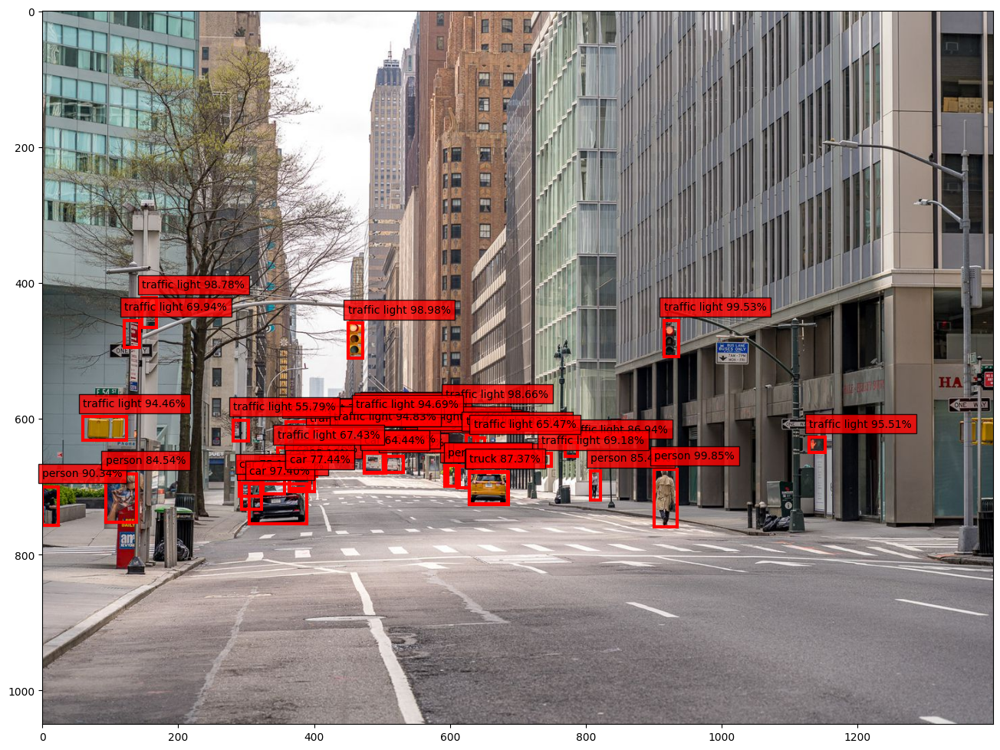

In [17]:
plotar_deteccao(imagem=imagem, deteccao=deteccao)
plt.show()

In [18]:
deteccao=detector(imagem, threshold=0.1)
deteccao

[{'score': 0.2587818503379822,
  'label': 'person',
  'box': {'xmin': 107, 'ymin': 684, 'xmax': 141, 'ymax': 729}},
 {'score': 0.8660395741462708,
  'label': 'traffic light',
  'box': {'xmin': 548, 'ymin': 620, 'xmax': 564, 'ymax': 641}},
 {'score': 0.42910218238830566,
  'label': 'truck',
  'box': {'xmin': 307, 'ymin': 691, 'xmax': 384, 'ymax': 741}},
 {'score': 0.4915789067745209,
  'label': 'traffic light',
  'box': {'xmin': 593, 'ymin': 583, 'xmax': 608, 'ymax': 609}},
 {'score': 0.989813506603241,
  'label': 'traffic light',
  'box': {'xmin': 450, 'ymin': 459, 'xmax': 472, 'ymax': 511}},
 {'score': 0.43020832538604736,
  'label': 'car',
  'box': {'xmin': 512, 'ymin': 654, 'xmax': 540, 'ymax': 679}},
 {'score': 0.8340935111045837,
  'label': 'traffic light',
  'box': {'xmin': 540, 'ymin': 625, 'xmax': 556, 'ymax': 646}},
 {'score': 0.6735727787017822,
  'label': 'car',
  'box': {'xmin': 375, 'ymin': 664, 'xmax': 404, 'ymax': 685}},
 {'score': 0.9131616353988647,
  'label': 'traffic

In [19]:
len(deteccao)

94

In [20]:
min(det['score'] for det in deteccao)

0.1045110896229744

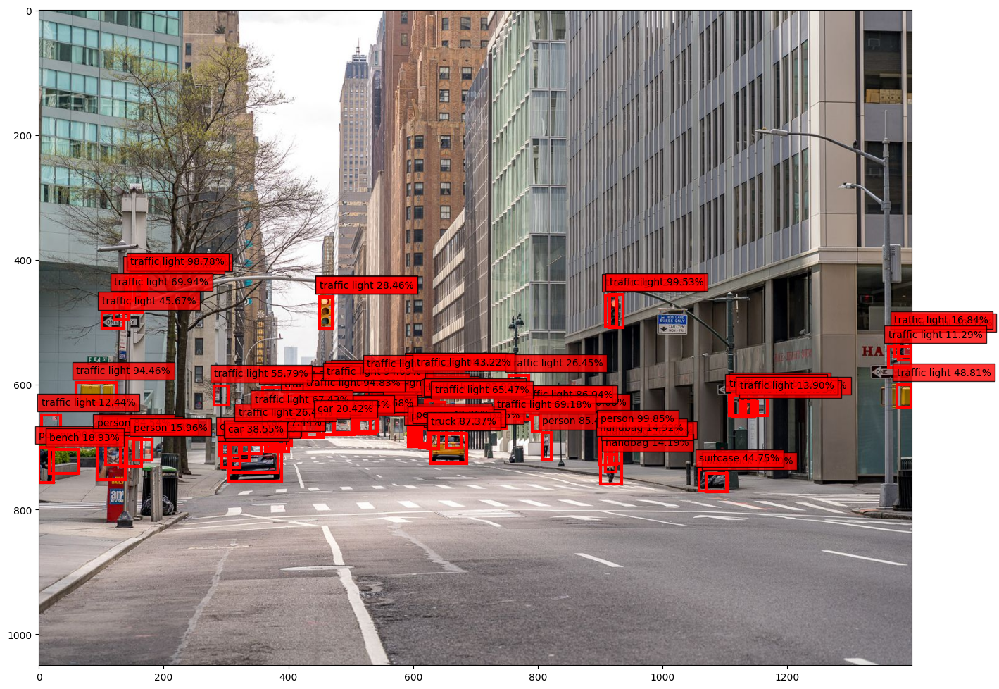

In [21]:
plotar_deteccao(imagem=imagem, deteccao=deteccao)
plt.show()

In [22]:
from matplotlib import colormaps
import numpy as np

def plotar_deteccao(imagem, deteccao, colormap='viridis'):
    labels = {det['label'] for det in deteccao}
    indices_cor = np.linspace(0, 1, len(labels))
    cores = [colormaps.get_cmap(colormap)(x) for x in indices_cor]
    cores = dict(zip(labels, cores))
    
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.imshow(imagem)
    
    for det in deteccao:
        box = det['box']
        cor = cores[det['label']]
        origem = (box['xmin'], box['ymin'])
        largura = box['xmax'] - box['xmin']
        altura = box['ymax'] - box['ymin']
        
        rect = patches.Rectangle(origem, largura, altura, linewidth=3, edgecolor=cor, facecolor='none')
        ax.add_patch(rect)

        texto = f"{det['label']} {100 * det['score']:.2f}%"
        ax.text(box['xmin'], box['ymin'] - 15, texto, bbox={'facecolor': cor, 'alpha': 0.8})

Counter({'traffic light': 12, 'car': 3, 'person': 2})


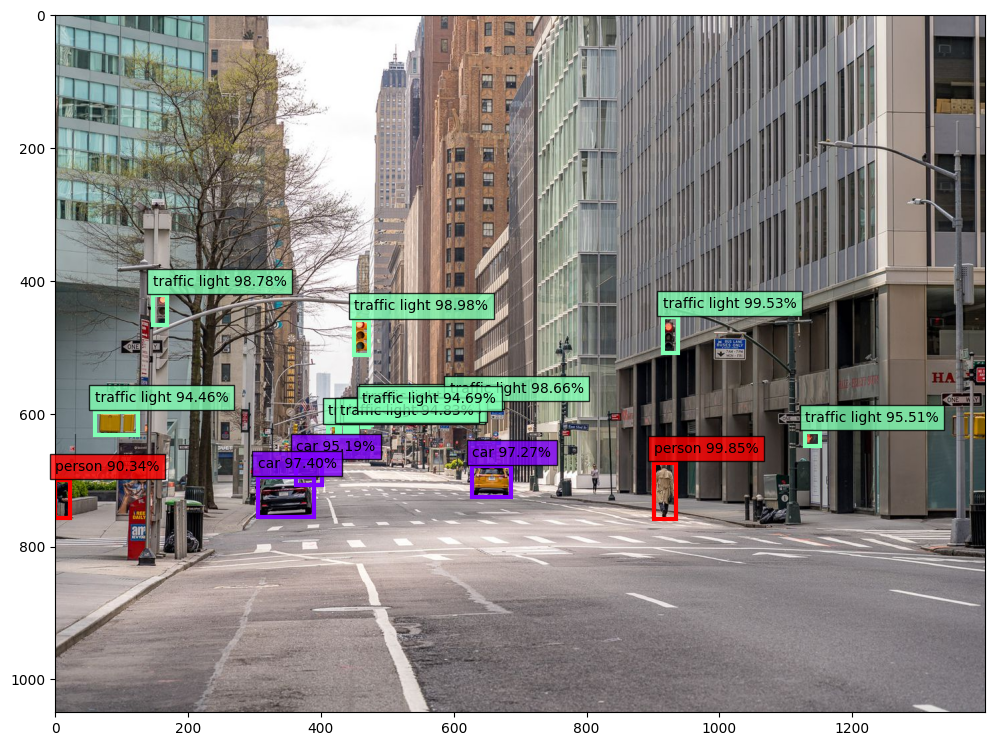

In [25]:
from collections import Counter

deteccao = detector(imagem, threshold=0.9)
contador = Counter(det['label'] for det in deteccao)
print(contador)

plotar_deteccao(imagem=imagem, deteccao=deteccao, colormap='rainbow')
plt.show()

Counter({'couch': 4, 'potted plant': 2, 'cell phone': 1, 'bowl': 1, 'tv': 1, 'wine glass': 1, 'apple': 1, 'dining table': 1})


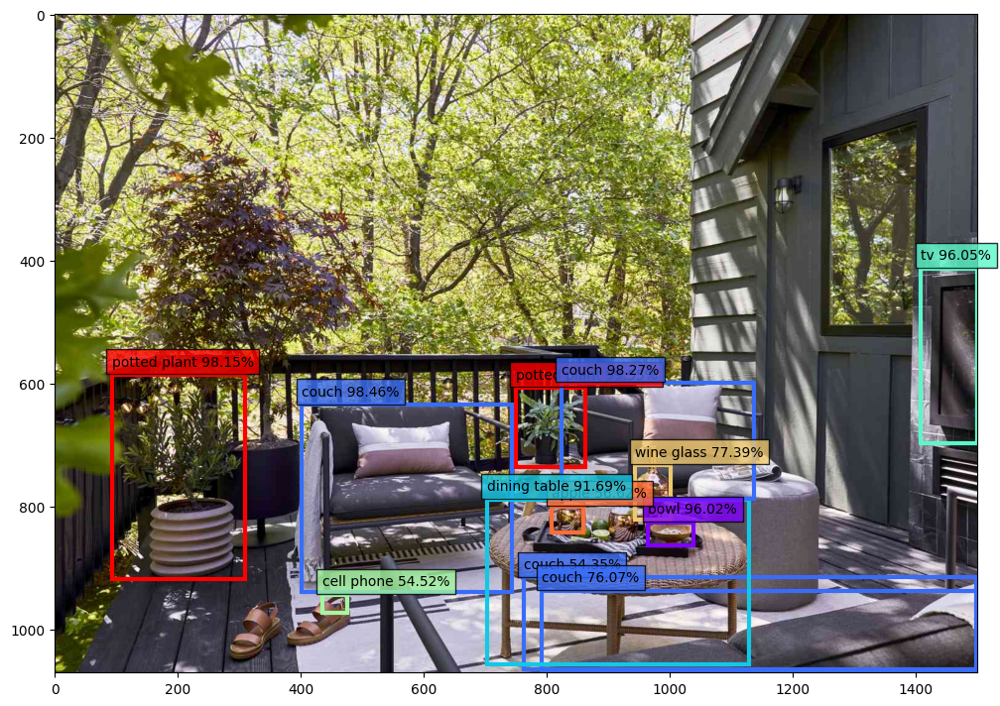

Counter({'bottle': 4, 'bowl': 2, 'sink': 2, 'toilet': 1})


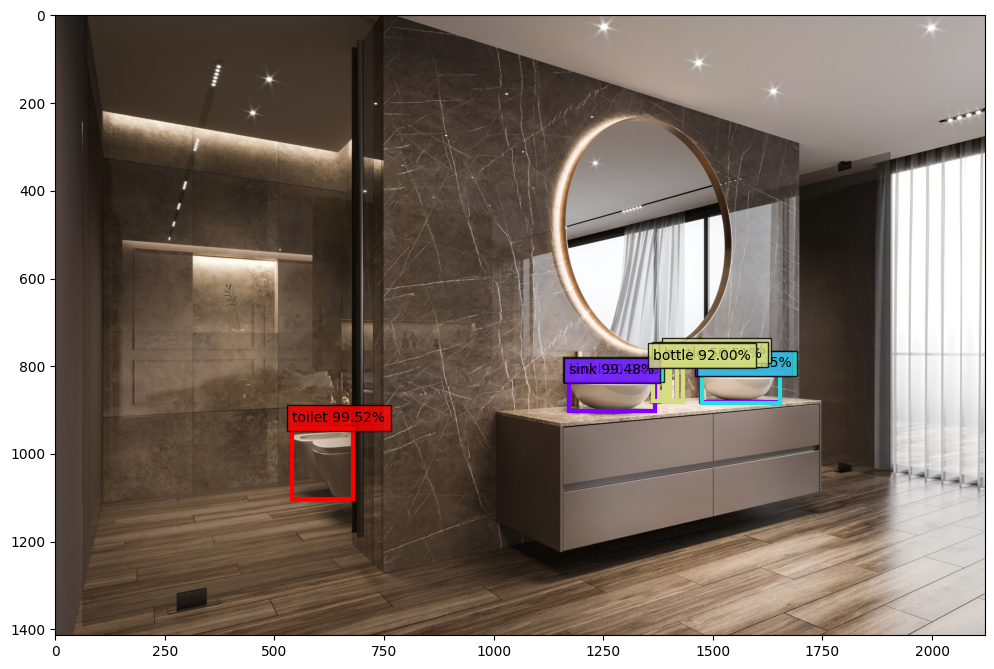

Counter({'potted plant': 4, 'couch': 4, 'vase': 3, 'chair': 2, 'book': 2, 'dining table': 1, 'tv': 1})


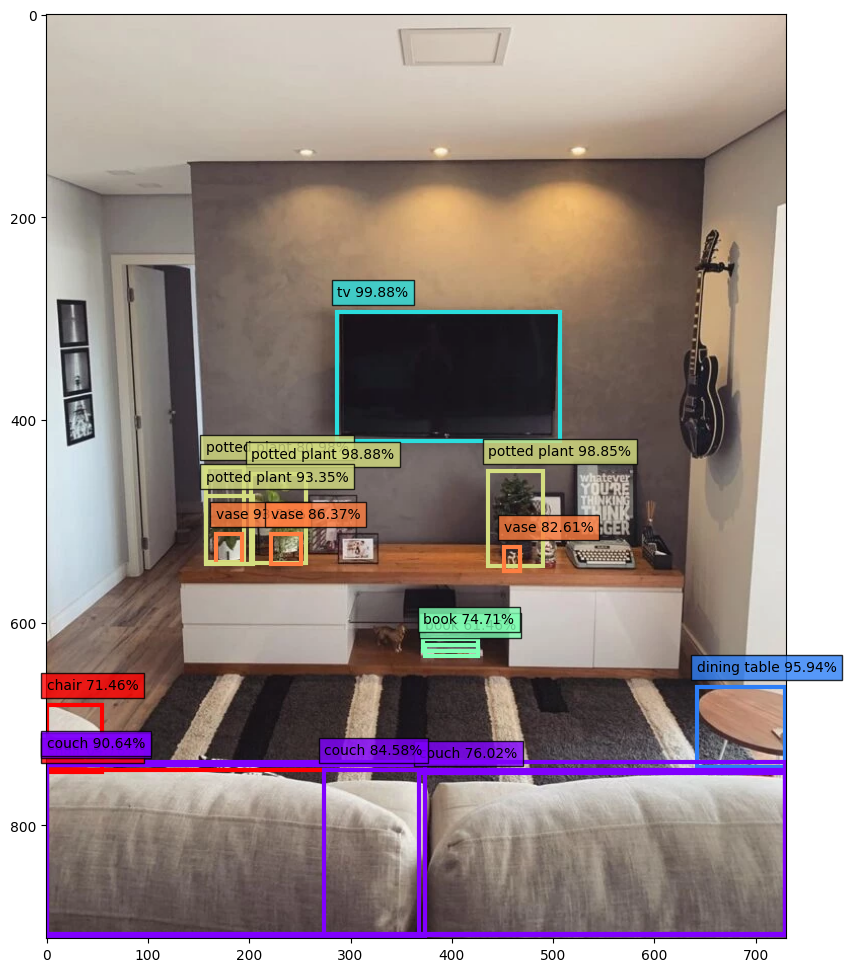

Counter({'chair': 3, 'vase': 3, 'couch': 2, 'potted plant': 2})


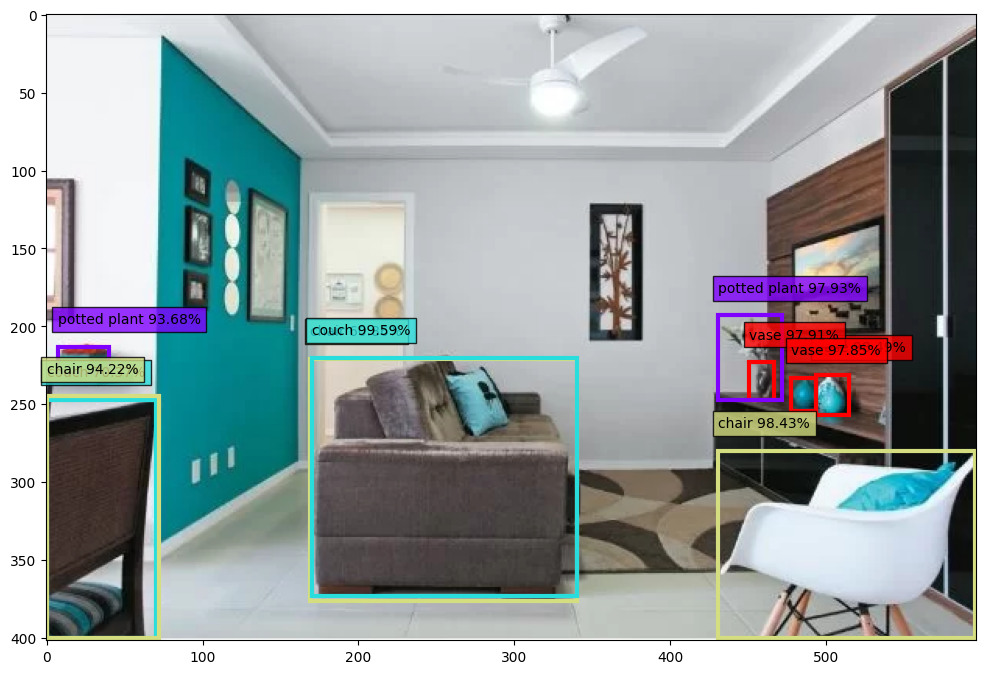

Counter({'person': 35, 'handbag': 2})


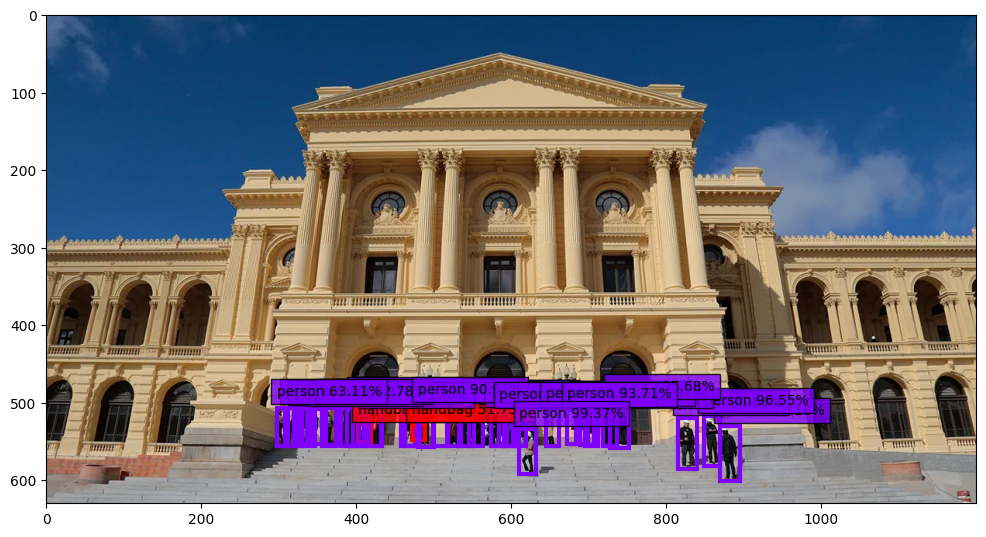

Counter({'book': 13, 'banana': 3, 'vase': 3, 'potted plant': 2, 'laptop': 1, 'chair': 1, 'cup': 1, 'dining table': 1, 'couch': 1})


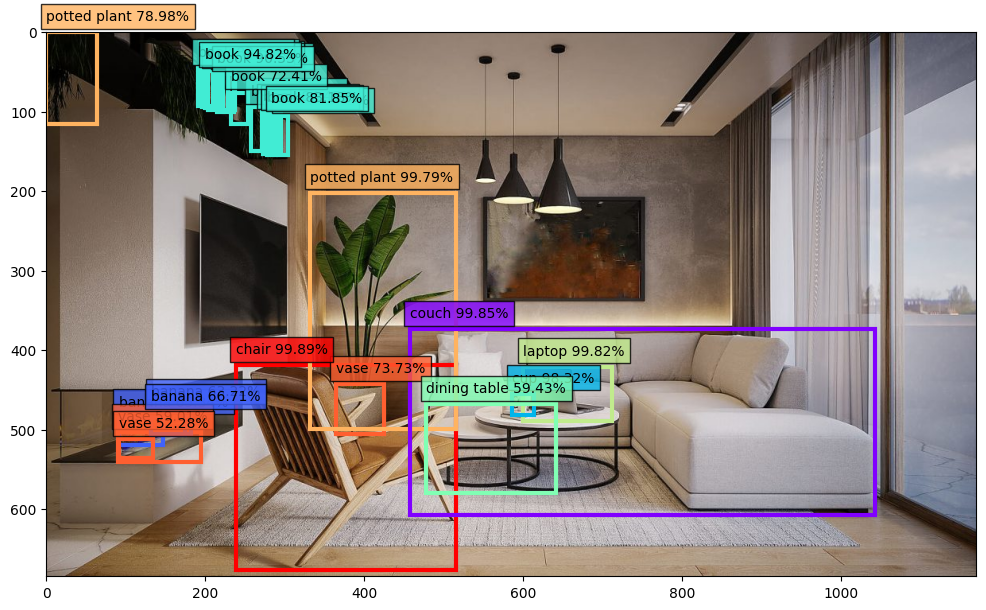

Counter({'chair': 4, 'sink': 3, 'vase': 1, 'cup': 1, 'bowl': 1, 'refrigerator': 1, 'potted plant': 1})


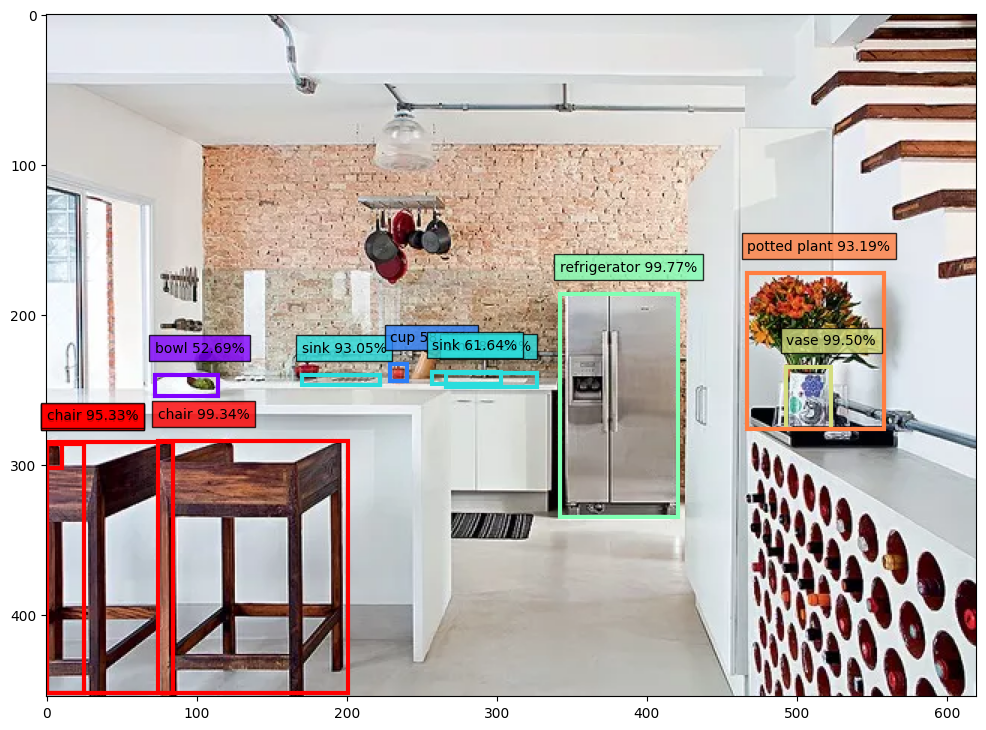

Counter({'potted plant': 2, 'sink': 2, 'toilet': 1})


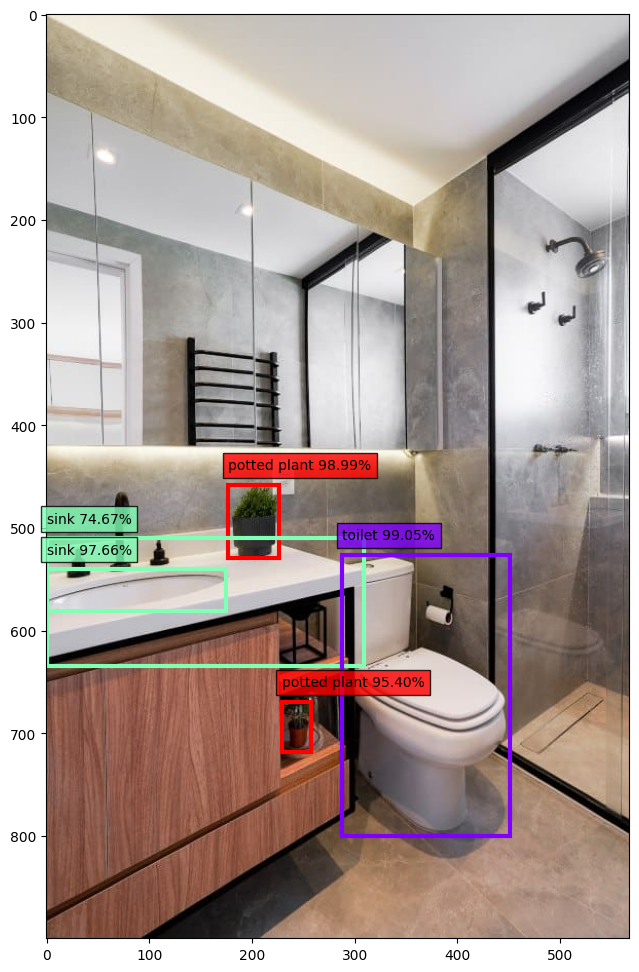

Counter()


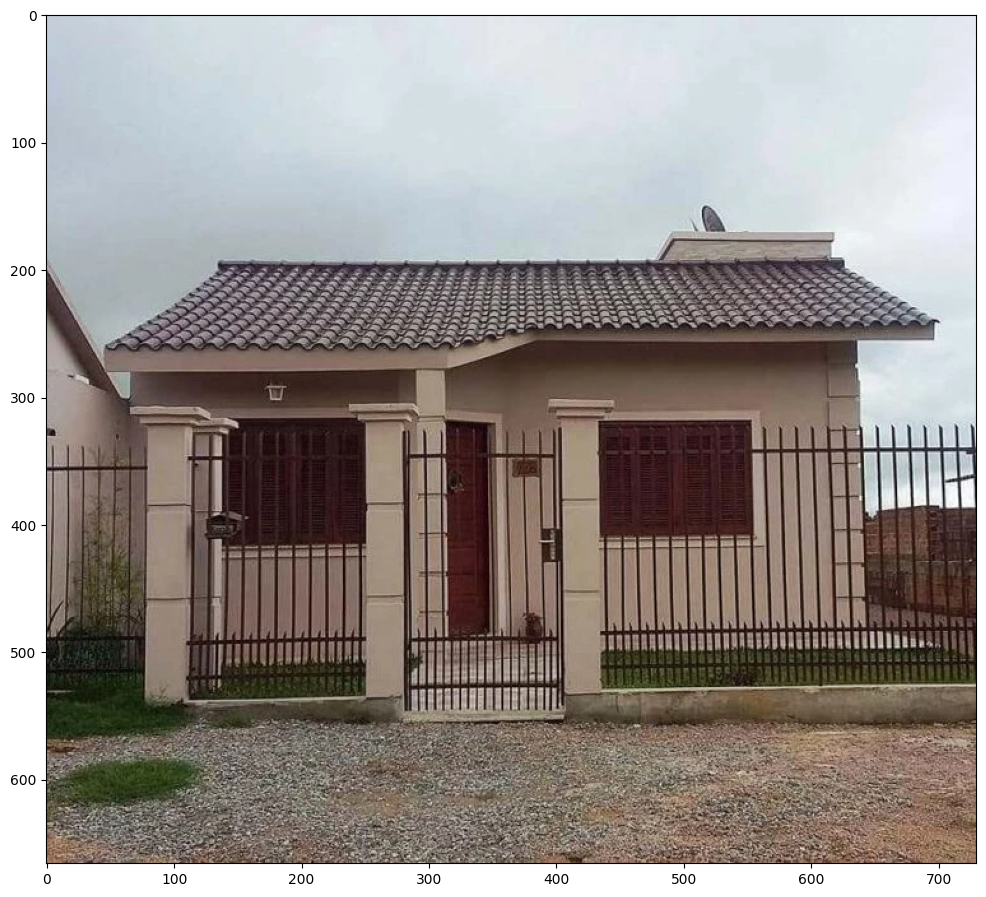

Counter({'bird': 10, 'car': 2, 'person': 1, 'cow': 1, 'handbag': 1})


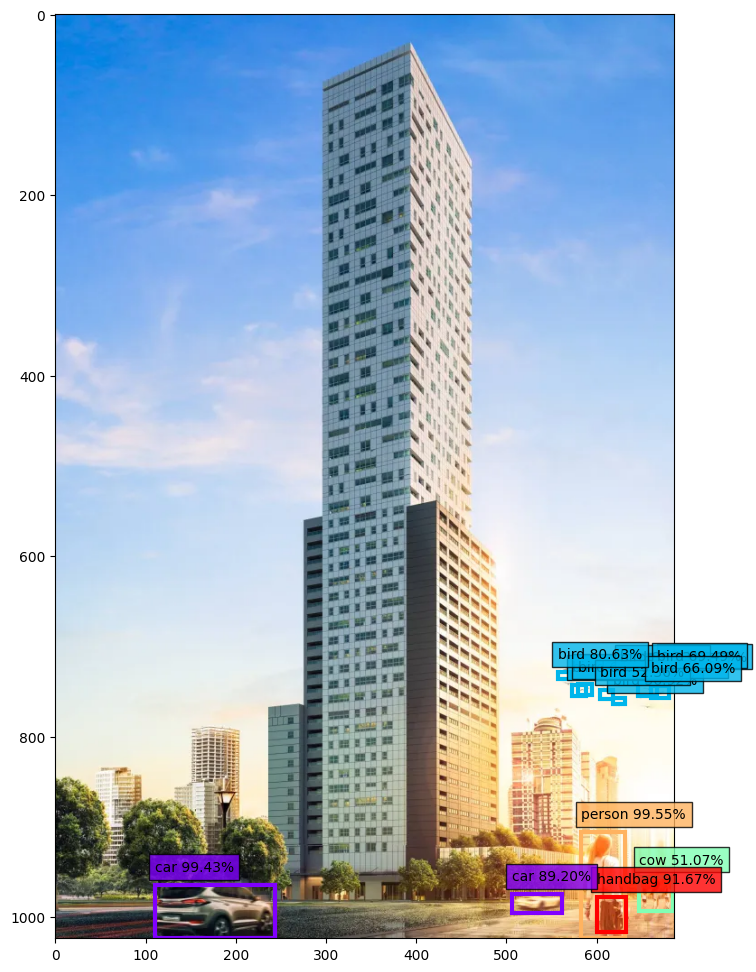

Counter({'person': 18, 'traffic light': 2, 'handbag': 2, 'bicycle': 1, 'fire hydrant': 1, 'backpack': 1})


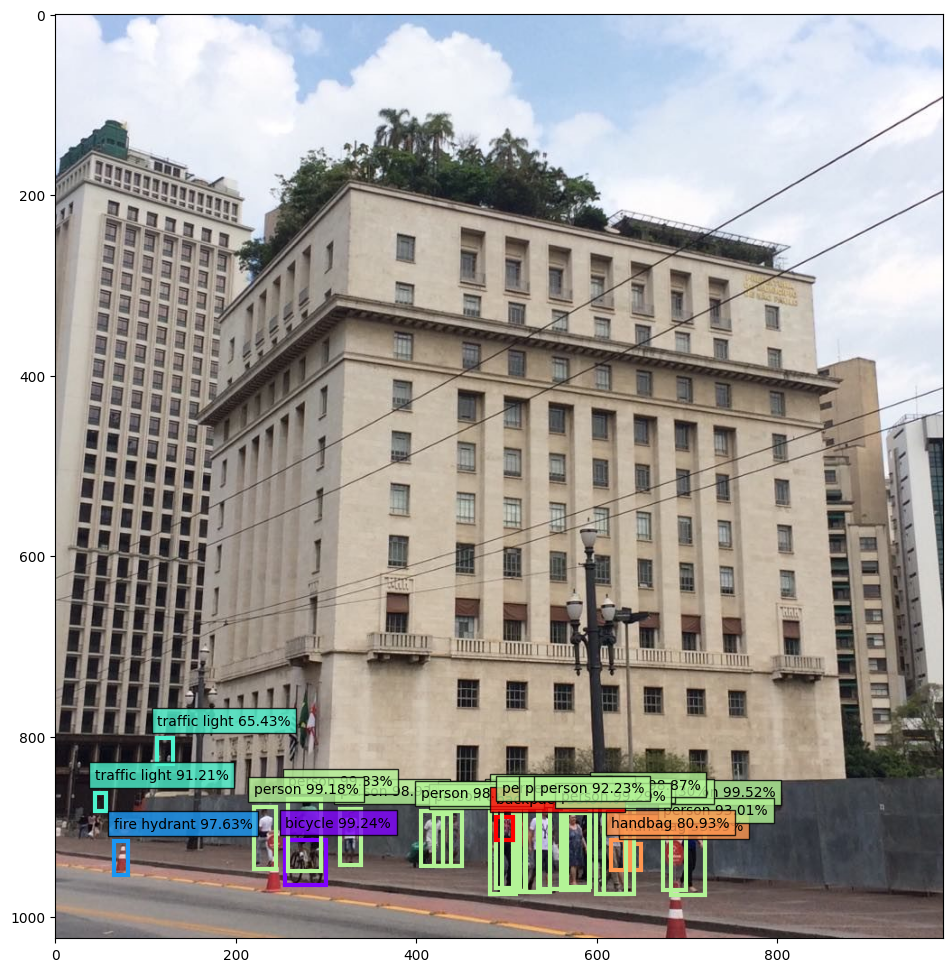

In [27]:
imagens = [Image.open(arquivo) for arquivo in Path('imagens/casas').iterdir()]

for imagem in imagens:
    deteccao = detector(imagem)
    contador = Counter(det['label'] for det in deteccao)
    print(contador)
    plotar_deteccao(imagem=imagem, deteccao=deteccao, colormap='rainbow')
    plt.show()

In [29]:
from datasets import load_dataset 

dados = load_dataset('cppe-5', split='train')
dados

Generating test split: 100%|██████████| 29/29 [00:00<00:00, 2866.58 examples/s]


Dataset({
    features: ['image_id', 'image', 'width', 'height', 'objects'],
    num_rows: 1000
})

In [30]:
dados[0]

{'image_id': 15,
 'image': <PIL.Image.Image image mode=RGB size=943x663>,
 'width': 943,
 'height': 663,
 'objects': {'id': [114, 115, 116, 117],
  'area': [3796, 1596, 152768, 81002],
  'bbox': [[302.0, 109.0, 73.0, 52.0],
   [810.0, 100.0, 57.0, 28.0],
   [160.0, 31.0, 248.0, 616.0],
   [741.0, 68.0, 202.0, 401.0]],
  'category': [4, 4, 0, 0]}}

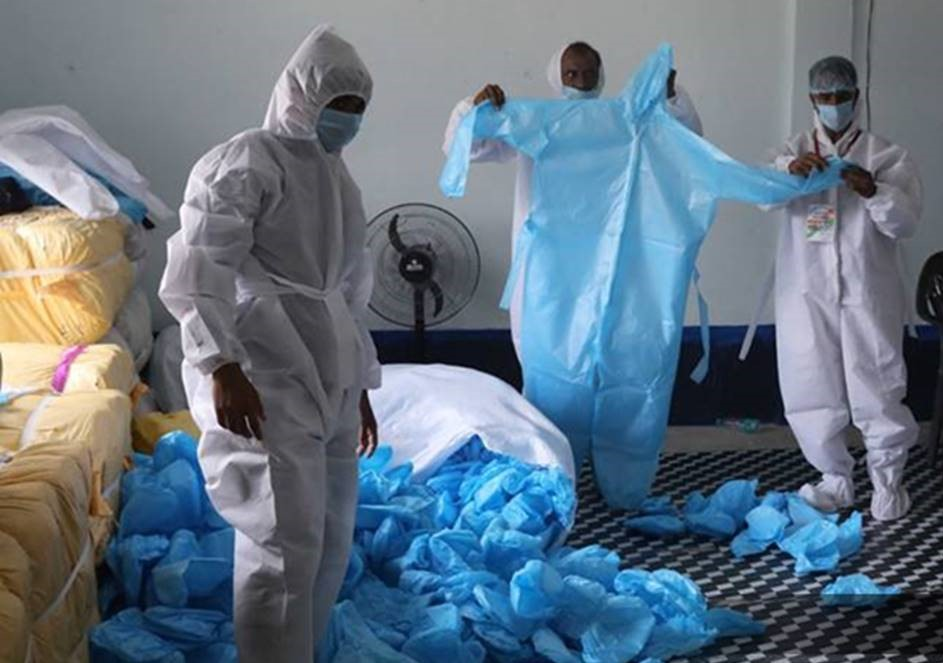

In [31]:
dados[0]['image']

In [32]:
modelo = 'devonho/detr-resnet-50_finetuned_cppe5'
detector = pipeline('object-detection', model=modelo)

Some weights of the model checkpoint at devonho/detr-resnet-50_finetuned_cppe5 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Counter({'Goggles': 4, 'Coverall': 2, 'Gloves': 1, 'Mask': 1})


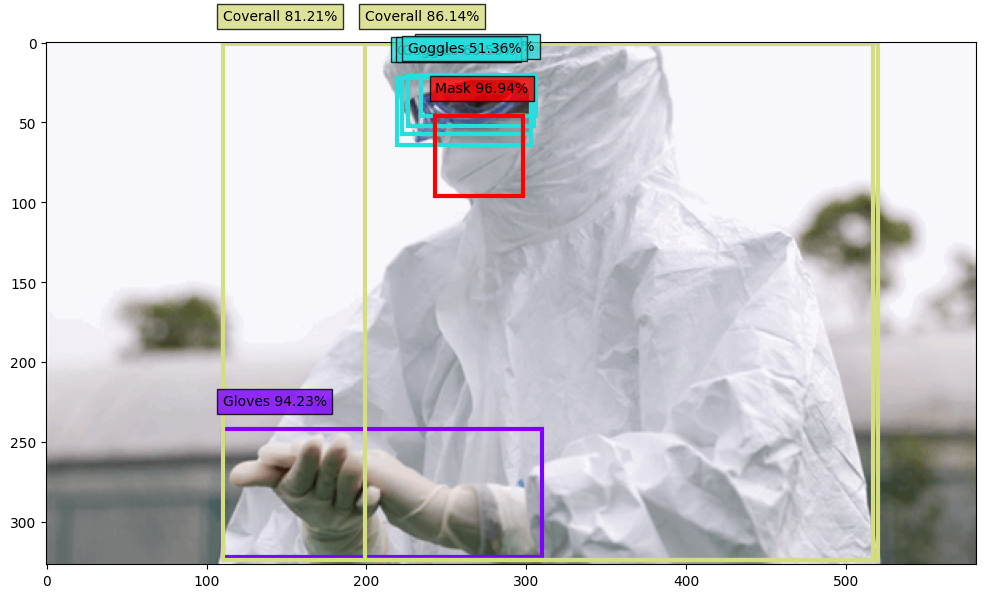

Counter({'Gloves': 2})


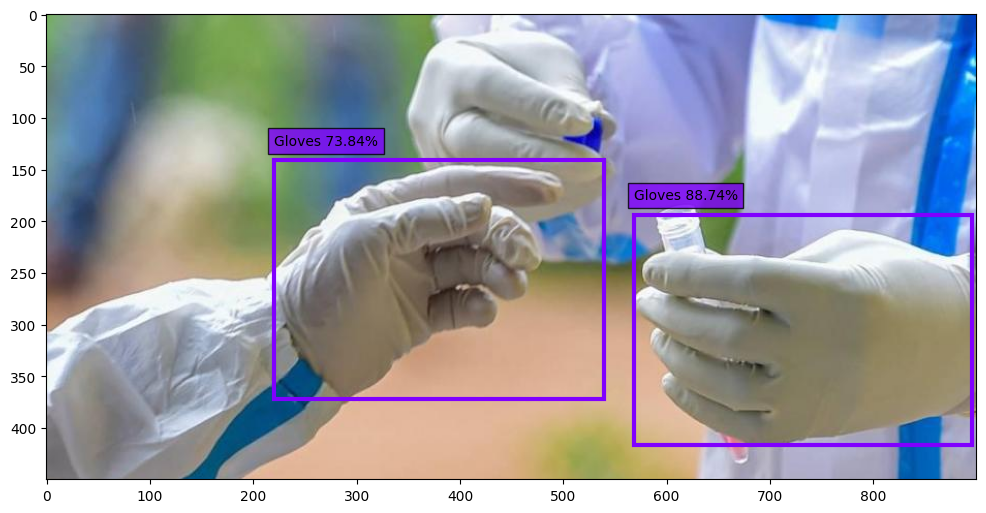

Counter({'Coverall': 4, 'Gloves': 2, 'Face_Shield': 2})


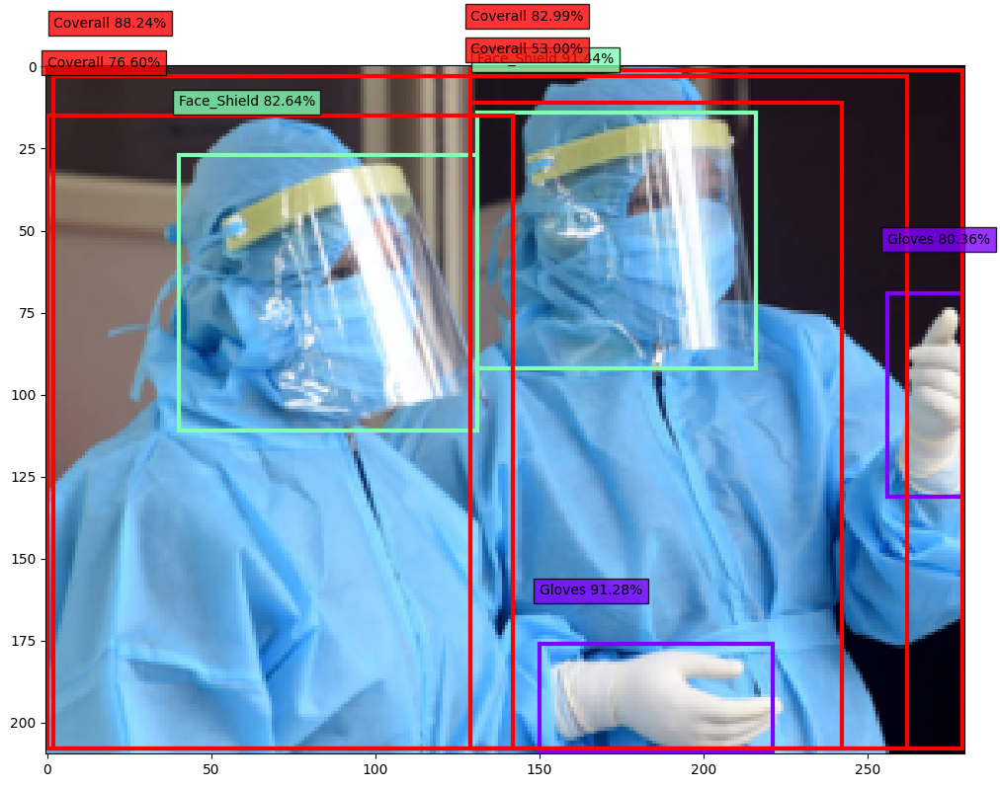

Counter({'Mask': 3, 'Gloves': 3, 'Face_Shield': 3, 'Coverall': 3})


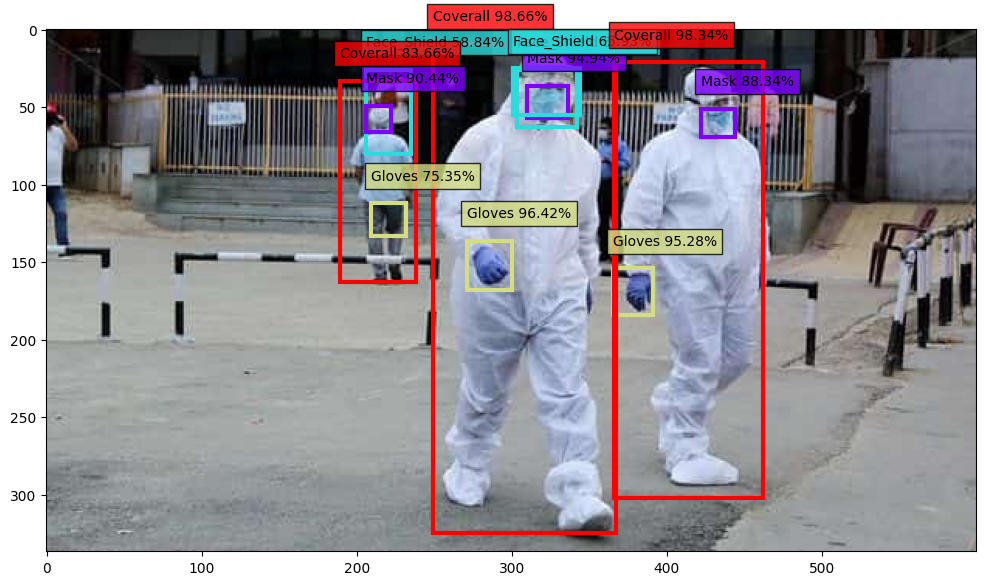

Counter({'Gloves': 1, 'Mask': 1, 'Coverall': 1})


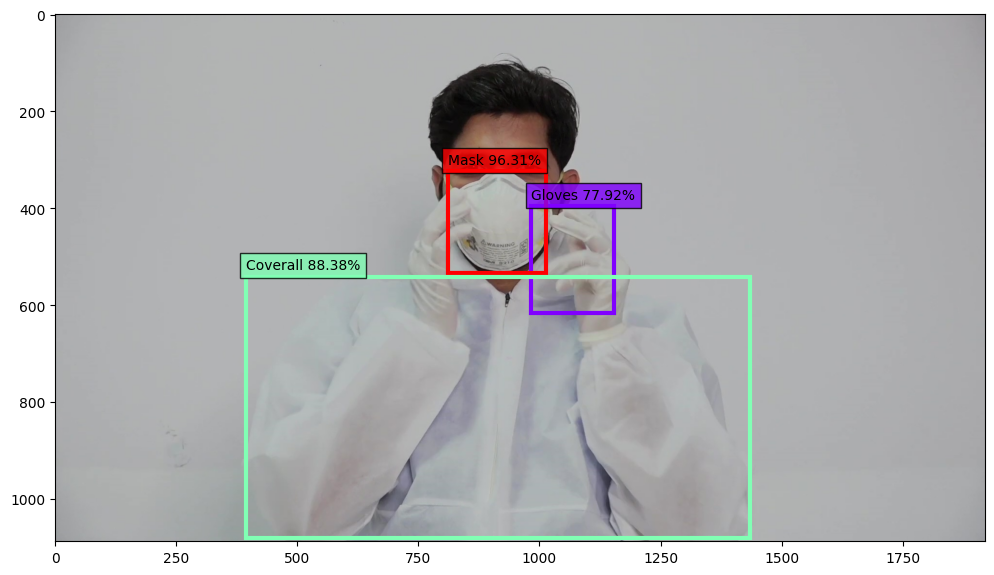

In [34]:
for linha in dados.select(range(50, 55)):
    imagem = linha['image']
    deteccao = detector(imagem)
    
    contador = Counter(det['label'] for det in deteccao)
    print(contador)
    
    plotar_deteccao(imagem=imagem, deteccao=deteccao, colormap='rainbow')
    plt.show()